<a href="https://colab.research.google.com/github/kungfumas/aplikasi-deep-learning/blob/master/GANDeOldify.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [4]:
!git clone https://github.com/jantic/DeOldify.git DeOldify 

Cloning into 'DeOldify'...
remote: Enumerating objects: 2253, done.
remote: Counting objects: 100% (25/25), done.
remote: Compressing objects: 100% (21/21), done.
remote: Total 2253 (delta 9), reused 16 (delta 4), pack-reused 2228
Receiving objects: 100% (2253/2253), 69.42 MiB | 34.59 MiB/s, done.
Resolving deltas: 100% (1016/1016), done.


In [5]:
cd DeOldify

/content/DeOldify


ERROR: Could not open requirements file: [Errno 2] No such file or directory: 'colab_requirements.txt'


In [6]:
#NOTE:  This must be the first call in order to work properly!
from deoldify import device
from deoldify.device_id import DeviceId
#choices:  CPU, GPU0...GPU7
device.set(device=DeviceId.GPU0)

import torch

if not torch.cuda.is_available():
    print('GPU not available.')

In [7]:
!pip install -r colab_requirements.txt

     |████████████████████████████████| 215kB 6.9MB/s 
     |████████████████████████████████| 133kB 10.9MB/s 
     |████████████████████████████████| 1.9MB 11.0MB/s 
     |████████████████████████████████| 81kB 11.5MB/s 
  Created wheel for ffmpeg: filename=ffmpeg-1.4-cp37-none-any.whl size=6084 sha256=ed85f83283f9ced11e7615e3a5598c7bba2d9c1d69b7dfe2c8f9489321e1d845
  Stored in directory: /root/.cache/pip/wheels/b6/68/c3/a05a35f647ba871e5572b9bbfc0b95fd1c6637a2219f959e7a
  Created wheel for typing: filename=typing-3.7.4.3-cp37-none-any.whl size=26323 sha256=aa1a8d4ed2ae87a9385b43316f48f0a2d99f1a15a3bcc4a78fcacfd9ddd9abb7
  Stored in directory: /root/.cache/pip/wheels/2d/04/41/8e1836e79581989c22eebac3f4e70aaac9af07b0908da173be
Successfully built ffmpeg typing
  Found existing installation: fastai 1.0.61
    Uninstalling fastai-1.0.61:
      Successfully uninstalled fastai-1.0.61


In [8]:
!cd ..


In [9]:
!dir

api_cmd_example.sh			ImageColorizer.ipynb
app.py					ImageColorizerStableTests.ipynb
app_utils.py				LICENSE
app-video.py				MANIFEST.in
colab_requirements.txt			quick_start.sh
ColorFIDBenchmarkArtistic.ipynb		README.md
ColorizeTrainingArtistic.ipynb		requirements-dev.txt
ColorizeTrainingStable.ipynb		requirements.txt
ColorizeTrainingStableLargeBatch.ipynb	resource_images
ColorizeTrainingVideo.ipynb		run_image_api.sh
ColorizeTrainingWandb.ipynb		run_notebook.sh
deoldify				run_video_api.sh
Dockerfile				set_password.py
Dockerfile-api				setup.py
environment.yml				test_images
fid					tox.ini
ImageColorizerArtisticTests.ipynb	VideoColorizerColab.ipynb
ImageColorizerColab.ipynb		VideoColorizer.ipynb
ImageColorizerColabStable.ipynb


In [13]:
import fastai
from deoldify.visualize import *
import warnings
warnings.filterwarnings("ignore", category=UserWarning, message=".*?Your .*? set is empty.*?")

In [14]:
!mkdir 'models'
!wget https://data.deepai.org/deoldify/ColorizeArtistic_gen.pth -O ./models/ColorizeArtistic_gen.pth

mkdir: cannot create directory ‘models’: File exists
--2021-06-05 07:25:42--  https://data.deepai.org/deoldify/ColorizeArtistic_gen.pth
Resolving data.deepai.org (data.deepai.org)... 138.201.36.183
Connecting to data.deepai.org (data.deepai.org)|138.201.36.183|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 255144681 (243M) [application/octet-stream]
Saving to: ‘./models/ColorizeArtistic_gen.pth’

./models/ColorizeAr 100%[===================>] 243.32M  20.3MB/s    in 13s     

2021-06-05 07:25:56 (18.9 MB/s) - ‘./models/ColorizeArtistic_gen.pth’ saved [255144681/255144681]



In [15]:
!wget https://media.githubusercontent.com/media/jantic/DeOldify/master/resource_images/watermark.png -O ./resource_images/watermark.png

--2021-06-05 07:26:09--  https://media.githubusercontent.com/media/jantic/DeOldify/master/resource_images/watermark.png
Resolving media.githubusercontent.com (media.githubusercontent.com)... 185.199.109.133, 185.199.111.133, 185.199.110.133, ...
Connecting to media.githubusercontent.com (media.githubusercontent.com)|185.199.109.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 9210 (9.0K) [image/png]
Saving to: ‘./resource_images/watermark.png’

./resource_images/w 100%[===================>]   8.99K  --.-KB/s    in 0s      

2021-06-05 07:26:09 (101 MB/s) - ‘./resource_images/watermark.png’ saved [9210/9210]



In [16]:
colorizer = get_image_colorizer(artistic=True)

/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:477: UserWarning: This DataLoader will create 8 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))
Downloading: "https://download.pytorch.org/models/resnet34-333f7ec4.pth" to /root/.cache/torch/hub/checkpoints/resnet34-333f7ec4.pth


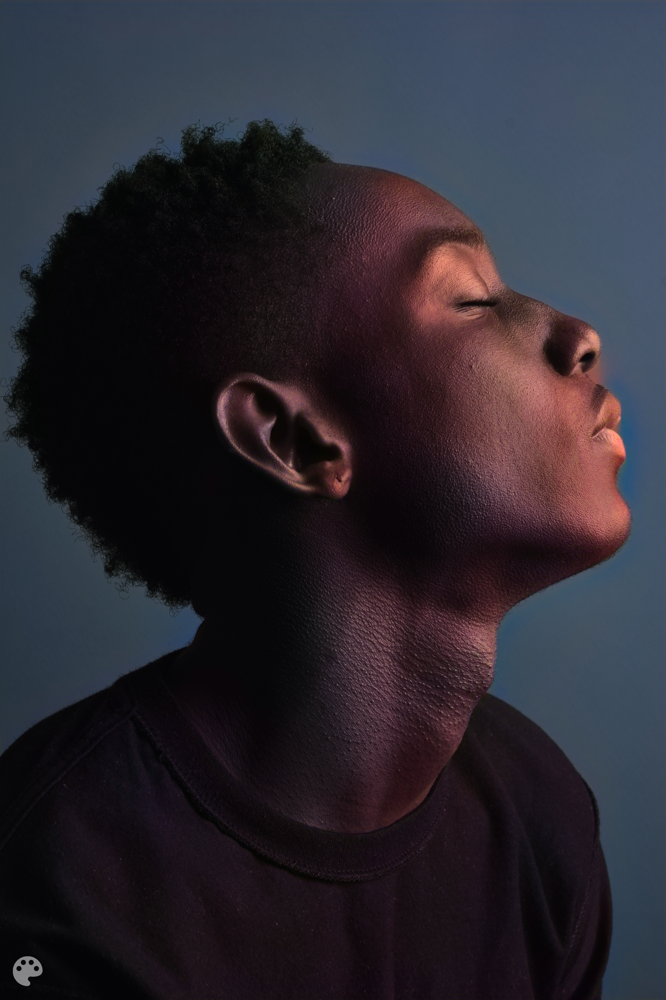

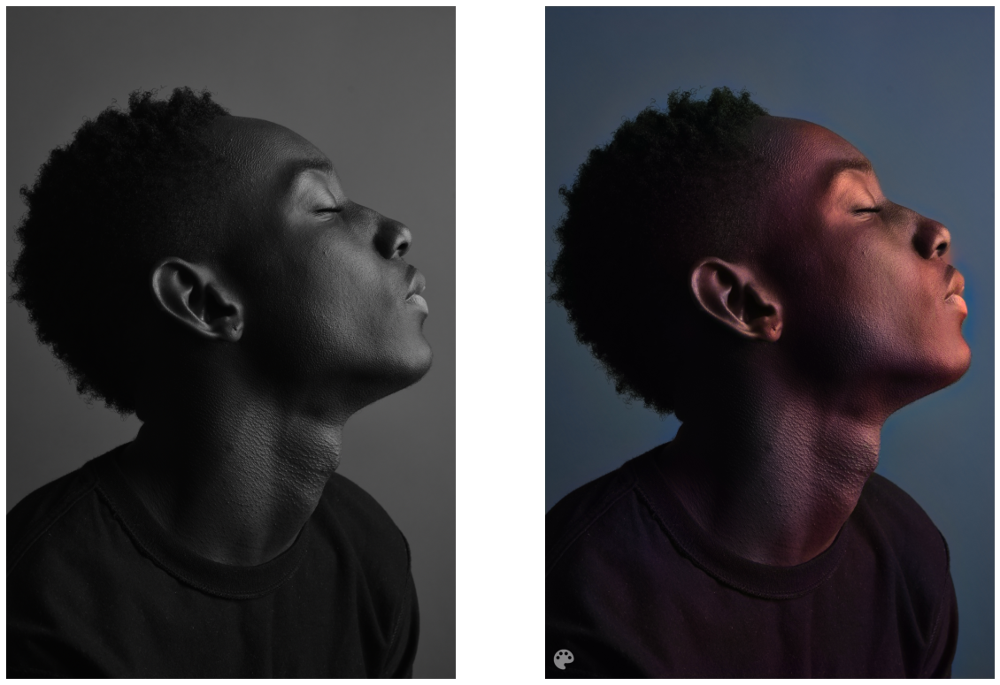

In [17]:
source_url = 'https://images.pexels.com/photos/3031397/pexels-photo-3031397.jpeg'
render_factor = 35  
watermarked = True 
image_path = colorizer.plot_transformed_image_from_url(url=source_url, render_factor=render_factor, compare=True, watermarked=watermarked)
 
show_image_in_notebook(image_path)

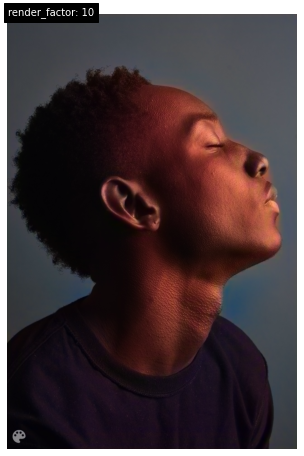

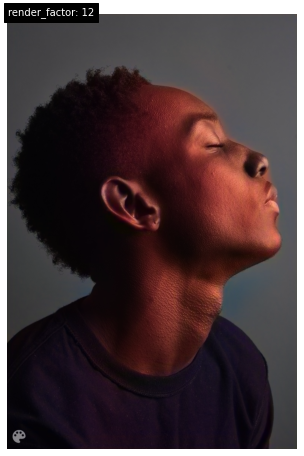

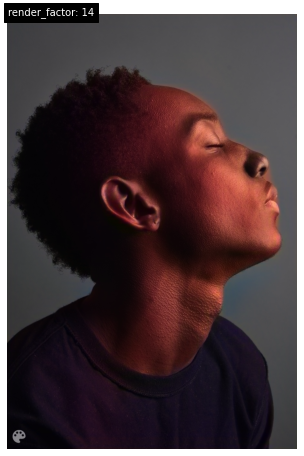

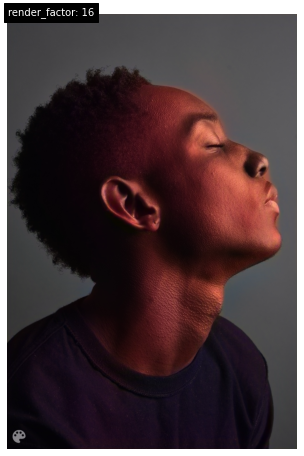

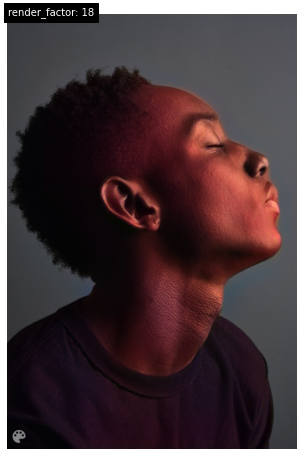

...

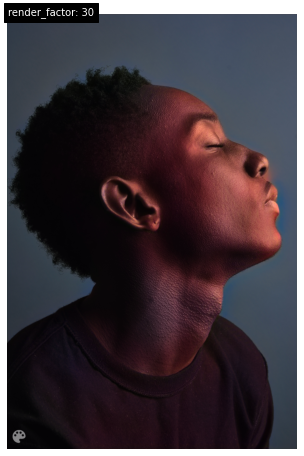

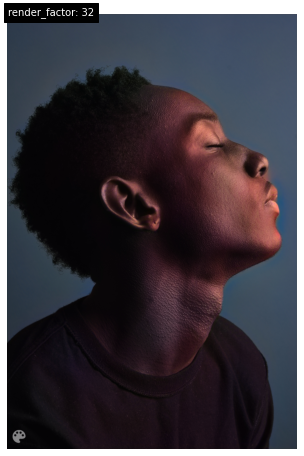

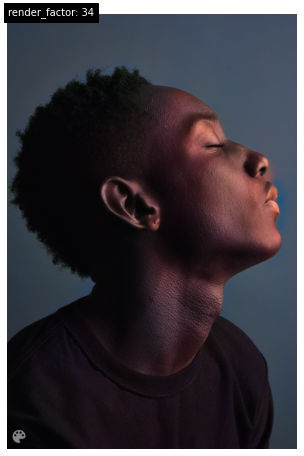

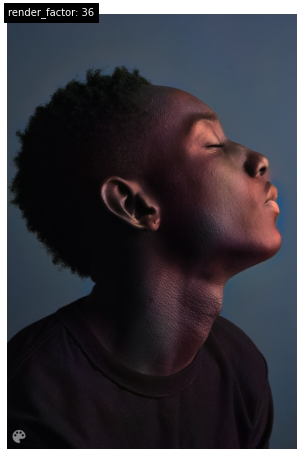

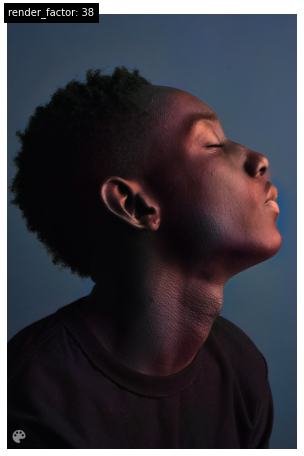

In [19]:
for i in range(10,40,2):
    colorizer.plot_transformed_image('/content/DeOldify/test_images/image.png', render_factor=i, display_render_factor=True, figsize=(8,8))

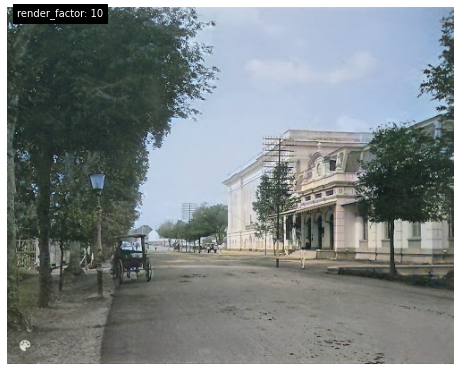

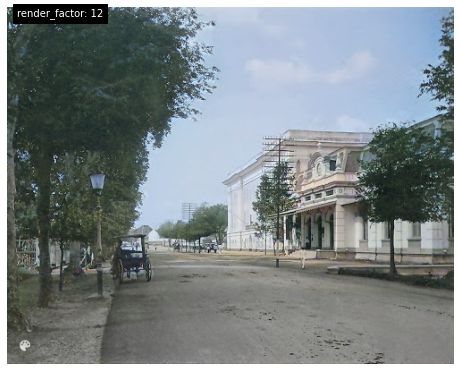

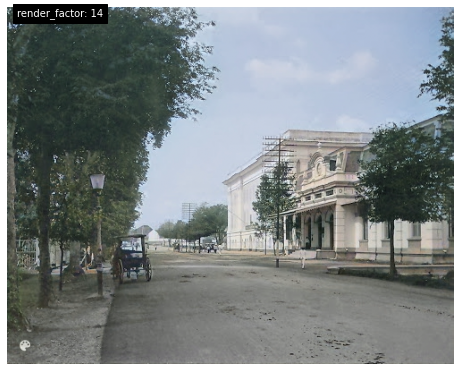

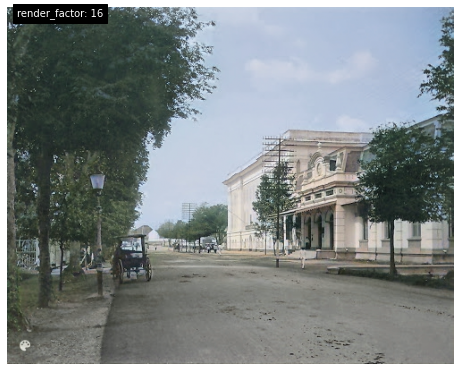

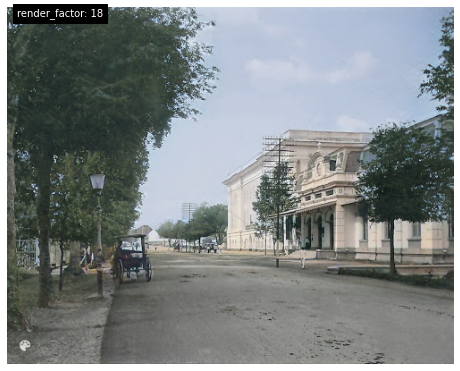

...

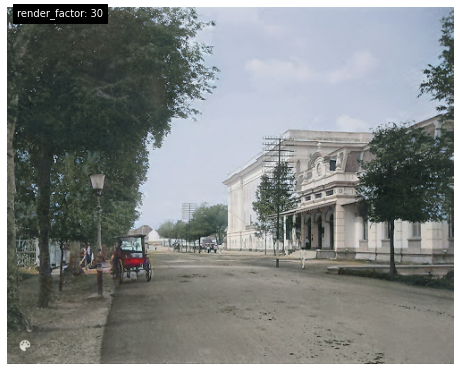

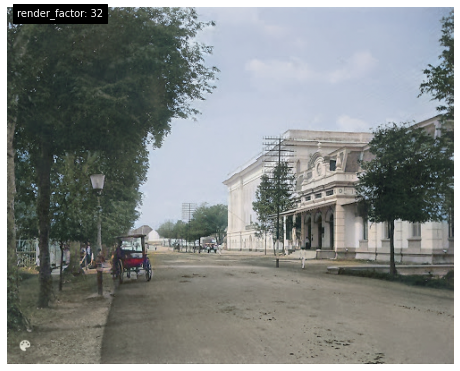

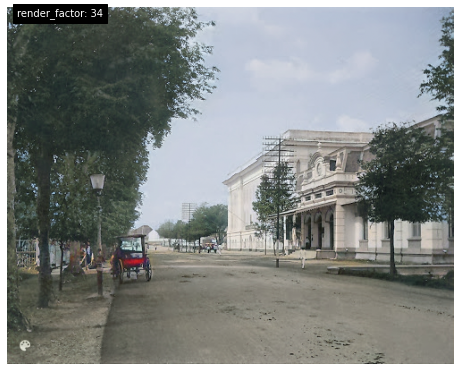

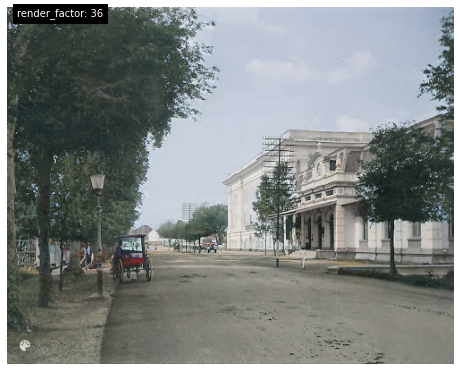

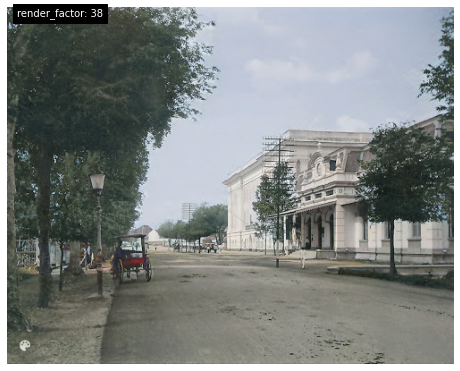

In [20]:
for i in range(10,40,2):
    colorizer.plot_transformed_image('/content/Kantor_Pos_dan_gubernuran.jpg', render_factor=i, display_render_factor=True, figsize=(8,8))

In [21]:
!wget https://data.deepai.org/deoldify/ColorizeVideo_gen.pth -O ./models/ColorizeVideo_gen.pth

--2021-06-05 07:47:59--  https://data.deepai.org/deoldify/ColorizeVideo_gen.pth
Resolving data.deepai.org (data.deepai.org)... 138.201.36.183
Connecting to data.deepai.org (data.deepai.org)|138.201.36.183|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 874066230 (834M) [application/octet-stream]
Saving to: ‘./models/ColorizeVideo_gen.pth’

./models/ColorizeVi 100%[===================>] 833.57M  19.7MB/s    in 44s     

2021-06-05 07:48:43 (19.2 MB/s) - ‘./models/ColorizeVideo_gen.pth’ saved [874066230/874066230]



In [22]:
colorizer = get_video_colorizer()

/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:477: UserWarning: This DataLoader will create 8 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))
Downloading: "https://download.pytorch.org/models/resnet101-5d3b4d8f.pth" to /root/.cache/torch/hub/checkpoints/resnet101-5d3b4d8f.pth


In [25]:
source_url = 'https://www.youtube.com/watch?v=iQpHPwQa-7E' 
render_factor = 21  
watermarked = True 
video_path = colorizer.colorize_from_url(source_url, 'video.mp4', render_factor, watermarked=watermarked)
show_video_in_notebook(video_path)

[youtube] iQpHPwQa-7E: Downloading webpage
[download] Destination: video/source/video.f136.mp4
[download] 100% of 5.46MiB in 00:01
[download] Destination: video/source/video.mp4.f140
[download] 100% of 2.12MiB in 00:00
[ffmpeg] Merging formats into "video/source/video.mp4"
Deleting original file video/source/video.f136.mp4 (pass -k to keep)
Deleting original file video/source/video.mp4.f140 (pass -k to keep)


Video created here: video/result/video.mp4
